In [176]:
import cv2 
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
%config IPCompleter.greedy=True

(440, 440, 3)

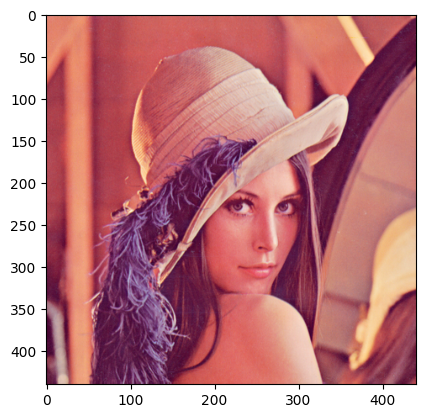

In [120]:
img_bgr = cv2.imread("/Users/tanishakhurana/Desktop/tkhuran3_project02/lena.png")
img_rgb = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2RGB)
img_gray = cv2.cvtColor(img_bgr, cv2.COLOR_BGR2GRAY)
plt.imshow(img_rgb)
img_rgb.shape

Zero padding

In [43]:
def zero_padding(padding,img):
    if len(img.shape) ==2:
        img_padded= np.zeros((img.shape[0] + 2 *padding, img.shape[1] + 2 *padding))
        #padding the image
        img_padded[padding: img_padded.shape[0]- padding, padding: img_padded.shape[1]- padding] = img
        cv2.imwrite("img_gray_padded.png",img_padded)
        
    if len(img.shape) ==3:
        img_padded= np.zeros((img.shape[0] + 2 *padding, img.shape[1] + 2 *padding,img.shape[2]))
        #padding the image
        img_padded[padding: img_padded.shape[0]- padding, padding: img_padded.shape[1]- padding] = img
        cv2.imwrite("img_bgr_padded.png",img_padded)
       
    return img_padded

For getting new convolved image shape. 

In [24]:
def get_convolved_img_shape(img_padded, kernel):
    #convolved image shape =  M - n +1
    if len(img_padded.shape) == 2:
        new_img = np.zeros((img_padded.shape[0] - kernel.shape[0] + 1 ,img_padded.shape[1] - kernel.shape[1] +1 ))

    if len(img_padded.shape) == 3:
        new_img = np.zeros((img_padded.shape[0] - kernel.shape[0] + 1 ,img_padded.shape[1] - kernel.shape[1] +1,img_padded.shape[2]))

    return new_img

Convolution function

In [25]:
def convolution(img_padded,new_img,kernel):
    if len(img_padded.shape) ==2:
        # convolution grayscale
        for row in range(new_img.shape[0]):
            for col in range(new_img.shape[1]):
                new_img[row,col] = np.sum(img_padded[row:row+kernel.shape[0],col:col + kernel.shape[1]] * kernel)
        cv2.imwrite("convoluted_img.png",new_img)

    if len(img_padded.shape) ==3:
        # #convolution rgb 
        for row in range(new_img.shape[0]):
            for col in range(new_img.shape[1]):
                for channel in range(new_img.shape[2]):
                    new_img[row,col,channel] = np.sum(img_padded[row:row+kernel.shape[0],col:col + kernel.shape[1],channel] * kernel)
                    
        cv2.imwrite("convoluted_img_rgb.png",new_img)
    return new_img


Types of kernels

In [26]:
box_kernel = np.array([
    [1/9, 1/9, 1/9],
    [1/9 , 1/9, 1/9],
    [1/9, 1/9, 1/9]])

In [27]:
first_derivative_filter1 = np.array([[-1,1]])
first_derivative_filter2 = np.array([[-1],[1]])

In [28]:
prewitt_x = np.array([
    [-1, 0, 1],
    [-1, 0, 1],
    [-1, 0, 1]])

prewitt_y = np.array([
    [1, 1, 1],
    [0, 0, 0],
    [-1, -1, -1]])


In [29]:
sobel_x = np.array([
    [-1, 0, 1],
    [-2, 0, 2],
    [-1, 0, 1]])

sobel_y = np.array([
    [1, 2, 1],
    [0, 0, 0],
    [-1, -2, -1]])


In [30]:
roberts_x = np.array([
    [0,1],
    [-1,0]])

roberts_y = np.array([
    [1,0],
    [0,-1]])


In [93]:
padding= 20

(480, 480)


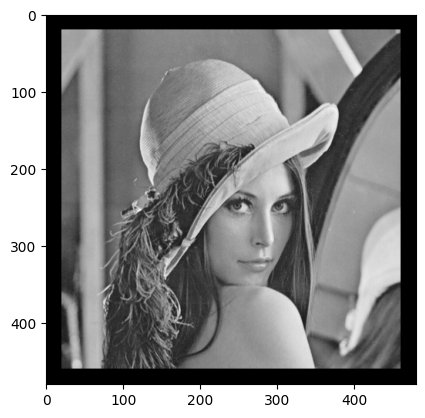

In [178]:
img_gray_padded= zero_padding(padding,img_gray)
img_rgb_padded= zero_padding(padding,img_rgb)
print(img_gray_padded.shape)
plt.imshow(img_gray_padded,cmap="gray")

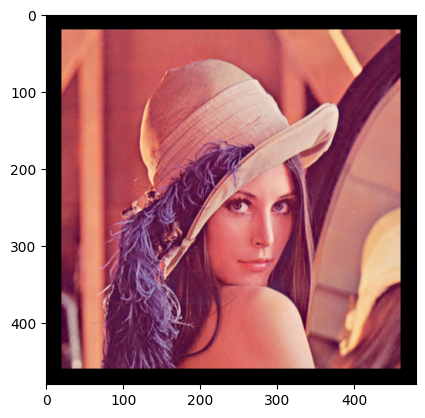

In [95]:
plt.imshow(img_rgb_padded.astype(np.uint8))

In [96]:
new_img_gray = get_convolved_img_shape(img_gray_padded, box_kernel)
new_img_rgb = get_convolved_img_shape(img_rgb_padded, box_kernel)


Performing convolution on zero padding

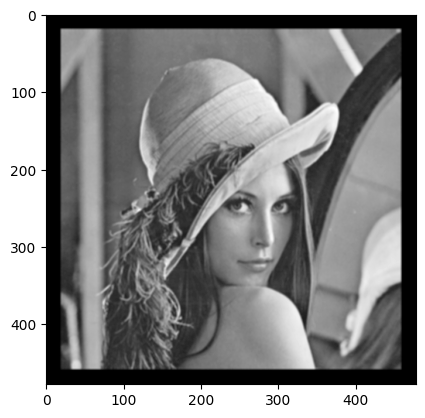

In [97]:
new_img_gray = convolution(img_gray_padded,new_img_gray,box_kernel)
new_img_rgb = convolution(img_rgb_padded,new_img_rgb,box_kernel)
plt.imshow(new_img_gray,cmap ="gray")

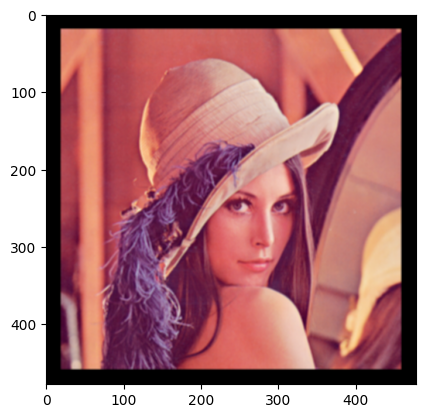

In [98]:
plt.imshow(new_img_rgb.astype(np.uint8))

In [99]:
def flipv(img):
    if len(img.shape) ==2:
        img2= np.zeros([img.shape[0], img.shape[1]], np.uint8)
        for i in range(img.shape[0]):

            img2[i,:]=img[img.shape[0]-i-1,:]
    if len(img.shape) ==3:
        img2= np.zeros([img.shape[0], img.shape[1], img.shape[2]], np.uint8)
        for i in range(img.shape[0]):

            img2[i,:]=img[img.shape[0]-i-1,:]

    return img2

In [100]:
def fliph(img):
    if len(img.shape) ==2:
        img2= np.zeros([img.shape[0], img.shape[1]], np.uint8)
        for i in range(img.shape[1]):

            img2[:,i]=img[:,img.shape[1]-i-1]
    if len(img.shape) ==3:
        img2= np.zeros([img.shape[0], img.shape[1],img.shape[2]], np.uint8)
        for i in range(img.shape[1]):

            img2[:,i]=img[:,img.shape[1]-i-1]

    return img2

In [302]:
img_gray

array([[143, 144, 145, ..., 151, 139, 110],
       [143, 144, 145, ..., 151, 139, 110],
       [143, 144, 145, ..., 150, 138, 110],
       ...,
       [ 38,  39,  43, ...,  87,  84,  80],
       [ 38,  42,  46, ...,  83,  86,  86],
       [ 39,  42,  48, ...,  82,  87,  89]], dtype=uint8)

In [303]:
height,width = img_gray.shape
img_gray_padded= zero_padding(padding,img_gray)


In [ ]:
right_padding_edge = img_gray[:,:padding]

In [304]:
left_padded_edge = img_gray[:,-padding:]


In [307]:
img_gray_padded[padding:-padding,0:padding] = right_padding_edge

In [308]:
img_gray_padded

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [143., 144., 143., ..., 110.,   0.,   0.],
       ...,
       [ 39.,  42.,  39., ...,  89.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.]])

In [310]:
img_gray_padded[padding:-padding,-padding:] = left_padded_edge

In [315]:
img_gray_padded

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [143., 144., 143., ..., 110., 139., 110.],
       ...,
       [ 39.,  42.,  39., ...,  89.,  87.,  89.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.]])

In [316]:
img_gray_padded.shape

(444, 444)

In [313]:
up_padded_edge = img_gray_padded[padding:2 *padding,:] 
up_padded_edge.shape

(2, 444)

In [317]:
img_gray_padded[:padding,:] = up_padded_edge


In [318]:
img_gray_padded

array([[143., 144., 143., ..., 110., 139., 110.],
       [143., 144., 143., ..., 110., 139., 110.],
       [143., 144., 143., ..., 110., 139., 110.],
       ...,
       [ 39.,  42.,  39., ...,  89.,  87.,  89.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.]])

In [324]:
down_padded_edge = img_gray_padded[img_gray.shape[0]:img_gray.shape[0]+padding,:] 

In [326]:
down_padded_edge.shape

(2, 444)

In [327]:
img_gray_padded[img_gray.shape[0]+padding:,:] = down_padded_edge

In [328]:
img_gray_padded

array([[143., 144., 143., ..., 110., 139., 110.],
       [143., 144., 143., ..., 110., 139., 110.],
       [143., 144., 143., ..., 110., 139., 110.],
       ...,
       [ 39.,  42.,  39., ...,  89.,  87.,  89.],
       [ 38.,  42.,  38., ...,  86.,  86.,  86.],
       [ 39.,  42.,  39., ...,  89.,  87.,  89.]])

In [329]:
height,width = img_gray.shape
img_gray2_padded= zero_padding(padding,img_gray)

In [330]:
img_gray2_padded

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0., 143., ..., 110.,   0.,   0.],
       ...,
       [  0.,   0.,  39., ...,  89.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.]])

In [344]:
right_edge = img_gray[:,:1]
left_edge = img_gray[:,-1:]
img_gray2_padded[padding:-padding,0:padding] = right_edge
img_gray2_padded

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [143., 143., 143., ..., 110.,   0.,   0.],
       ...,
       [ 39.,  39.,  39., ...,  89.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.]])

In [355]:
img_gray2_padded[padding:-padding,-padding:] = left_edge
img_gray2_padded

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [143., 143., 143., ..., 110., 110., 110.],
       ...,
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.]])

In [366]:
img_gray2_padded

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [143., 143., 143., ..., 110., 110., 110.],
       ...,
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.]])

In [365]:
down_edge = img_gray2_padded[img_gray.shape[0] + padding -1:-padding,:] 
up_edge = img_gray2_padded[padding : padding +1,:] 


In [370]:
img_gray2_padded[img_gray.shape[0]+padding:,:] = down_edge

In [371]:
img_gray2_padded

array([[  0.,   0.,   0., ...,   0.,   0.,   0.],
       [  0.,   0.,   0., ...,   0.,   0.,   0.],
       [143., 143., 143., ..., 110., 110., 110.],
       ...,
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [ 39.,  39.,  39., ...,  89.,  89.,  89.]])

In [372]:
img_gray2_padded[:padding,:] = up_edge

In [373]:
img_gray2_padded

array([[143., 143., 143., ..., 110., 110., 110.],
       [143., 143., 143., ..., 110., 110., 110.],
       [143., 143., 143., ..., 110., 110., 110.],
       ...,
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [ 39.,  39.,  39., ...,  89.,  89.,  89.]])

In [101]:
def reflection_padding(padding,img):
    img_padded= zero_padding(padding,img)
 
    right_padding_edge = img[:,:padding]
    left_padded_edge = img[:,-padding:]

    # flip the edges
    flipped_right_padded_edge = fliph(right_padding_edge)
    flipped_left_padded_edge = fliph(left_padded_edge)

    img_padded[padding:-padding,0:padding] = flipped_right_padded_edge
    img_padded[padding:-padding,-padding:] = flipped_left_padded_edge

    #up and down
    up_padded_edge = img_padded[padding:2 *padding,:] 
    down_padded_edge = img_padded[img.shape[0]:img.shape[0]+padding,:] 

    #flip up and down
    flipped_up_padded_edge = flipv(up_padded_edge)
    flipped_down_padded_edge = flipv(down_padded_edge)
    
    img_padded[:padding,:] = flipped_up_padded_edge
    img_padded[img.shape[0]+padding:,:] = flipped_down_padded_edge
    
    return img_padded

In [61]:
img_gray

array([[143, 144, 145, ..., 151, 139, 110],
       [143, 144, 145, ..., 151, 139, 110],
       [143, 144, 145, ..., 150, 138, 110],
       ...,
       [ 38,  39,  43, ...,  87,  84,  80],
       [ 38,  42,  46, ...,  83,  86,  86],
       [ 39,  42,  48, ...,  82,  87,  89]], dtype=uint8)

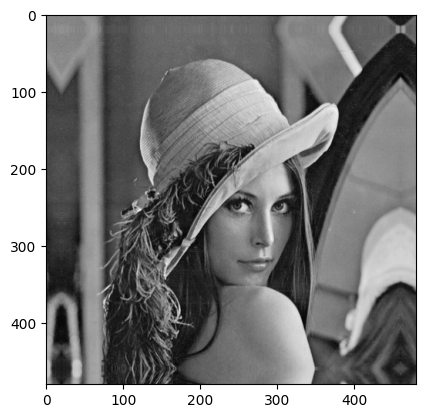

In [102]:
img_gray_padded = reflection_padding(padding,img_gray)
plt.imshow(img_gray_padded,cmap="gray")

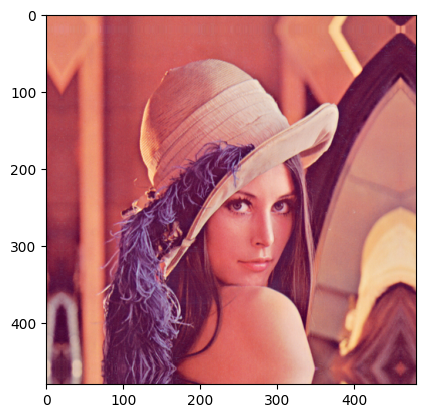

In [103]:
img_rgb_padded = reflection_padding(padding,img_rgb)
plt.imshow(img_rgb_padded.astype(np.uint8))

In [104]:
def wrap_around(padding,img):
    img_padded= zero_padding(padding,img)
 
    right_padding_edge = img[:,:padding]
    left_padded_edge = img[:,-padding:]
    
    #opposite side edges
    img_padded[padding:-padding,0:padding] = left_padded_edge
    img_padded[padding:-padding,-padding:] = right_padding_edge

    #up and down
    up_padded_edge = img_padded[padding:2 *padding,:] 
    down_padded_edge = img_padded[img.shape[0]:img.shape[0]+padding,:] 
    
    img_padded[:padding,:] = down_padded_edge
    img_padded[img.shape[0]+padding:,:] = up_padded_edge
    
    return img_padded

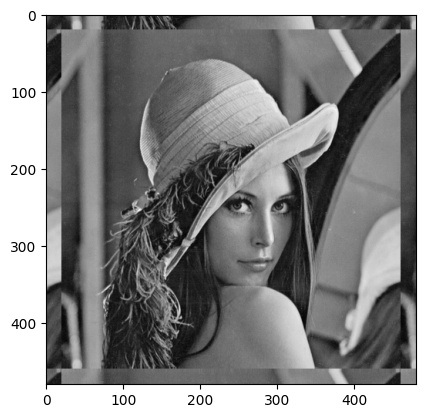

In [105]:
img_gray_padded = wrap_around(padding,img_gray)
plt.imshow(img_gray_padded,cmap="gray")

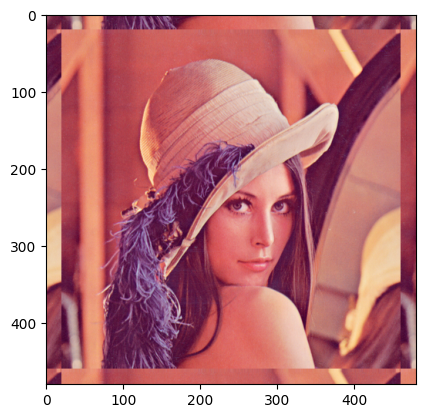

In [107]:
img_rgb_padded = wrap_around(padding,img_rgb)
plt.imshow(img_rgb_padded.astype(np.uint8))

In [108]:
img_gray_padded

array([[ 99.,  97.,  95., ..., 171., 172., 171.],
       [102.,  95.,  96., ..., 174., 174., 173.],
       [106.,  97.,  92., ..., 170., 172., 169.],
       ...,
       [107.,  95.,  84., ..., 133., 133., 139.],
       [ 96.,  78.,  58., ..., 135., 132., 131.],
       [ 76.,  53.,  44., ..., 136., 136., 136.]])

In [109]:
def copy_edge_padding(padding,img):
    img_padded= zero_padding(padding,img)
    
    right_edge = img[:,:1]
    left_edge = img[:,-1:]
    
    #only the last edge is needed
    img_padded[padding:-padding,0:padding] = right_edge
    img_padded[padding:-padding,-padding:] = left_edge
    
    down_edge = img_padded[img.shape[0] + padding -1:-padding,:] 
    up_edge = img_padded[padding : padding +1,:] 
    
    img_padded[img.shape[0]+padding:,:] = down_edge
    img_padded[:padding,:] = up_edge
    
    return img_padded

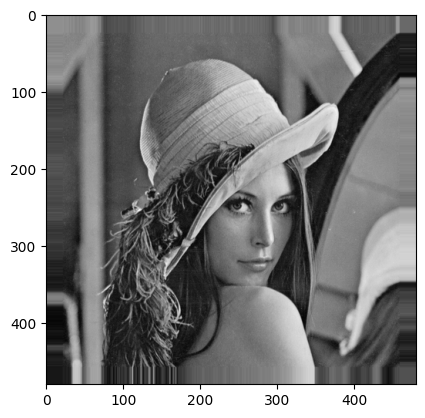

In [110]:
img_gray_padded = copy_edge_padding(padding,img_gray)
plt.imshow(img_gray_padded,cmap="gray")

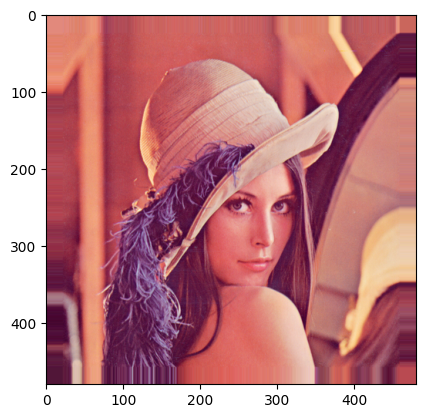

In [111]:
img_rgb_padded = copy_edge_padding(padding,img_rgb)
plt.imshow(img_rgb_padded.astype(np.uint8))

In [400]:
img_gray_padded

array([[143., 143., 143., ..., 110., 110., 110.],
       [143., 143., 143., ..., 110., 110., 110.],
       [143., 143., 143., ..., 110., 110., 110.],
       ...,
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [ 39.,  39.,  39., ...,  89.,  89.,  89.],
       [ 39.,  39.,  39., ...,  89.,  89.,  89.]])

padding = Copy edge padding


grayscale and rgb convolution 

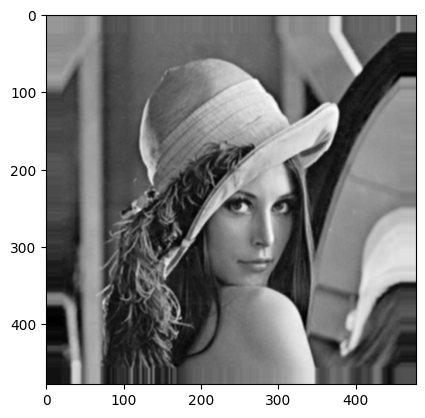

In [112]:
img_gray_padded = copy_edge_padding(padding,img_gray)


new_img_gray = get_convolved_img_shape(img_gray_padded, box_kernel)
new_img_gray = convolution(img_gray_padded,new_img_gray,box_kernel)
plt.imshow(new_img_gray,cmap ="gray")

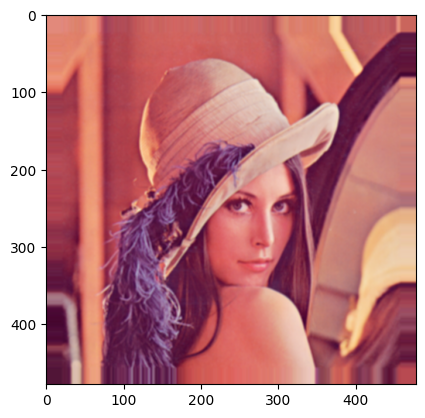

In [113]:
new_img_rgb = get_convolved_img_shape(img_rgb_padded, box_kernel)
new_img_rgb = convolution(img_rgb_padded,new_img_rgb,box_kernel)
plt.imshow(new_img_rgb.astype(np.uint8))

padding = wrap around padding

grayscale and rgb convolution

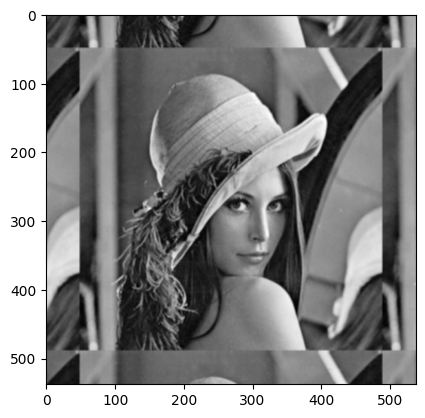

In [91]:
img_gray_padded = wrap_around(padding,img_gray)


new_img_gray = get_convolved_img_shape(img_gray_padded, box_kernel)
new_img_gray = convolution(img_gray_padded,new_img_gray,box_kernel)
plt.imshow(new_img_gray,cmap ="gray")

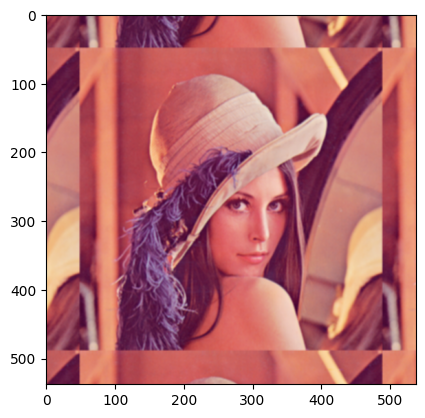

In [92]:
img_rgb_padded = wrap_around(padding,img_rgb)

new_img_rgb = get_convolved_img_shape(img_rgb_padded, box_kernel)
new_img_rgb = convolution(img_rgb_padded,new_img_rgb,box_kernel)
plt.imshow(new_img_rgb.astype(np.uint8))

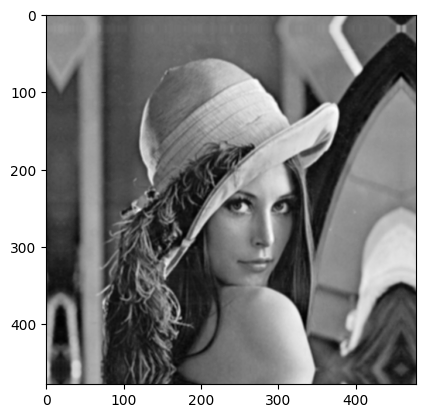

In [114]:
img_gray_padded = reflection_padding(padding,img_gray)


new_img_gray = get_convolved_img_shape(img_gray_padded, box_kernel)
new_img_gray = convolution(img_gray_padded,new_img_gray,box_kernel)
plt.imshow(new_img_gray,cmap ="gray")

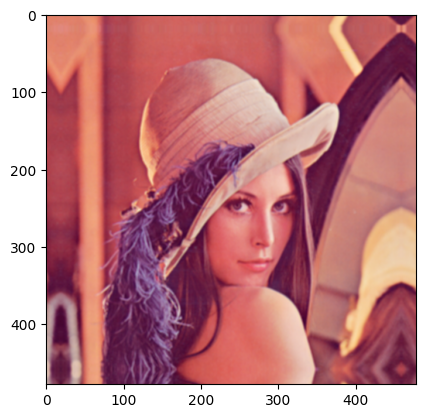

In [115]:
img_rgb_padded = reflection_padding(padding,img_rgb)

new_img_rgb = get_convolved_img_shape(img_rgb_padded, box_kernel)
new_img_rgb = convolution(img_rgb_padded,new_img_rgb,box_kernel)
plt.imshow(new_img_rgb.astype(np.uint8))

As we can see box filter blurs the image

Testing different kernels on wolves and lena image for reflection padding

In [116]:
kernel_list = [box_kernel,first_derivative_filter1 , first_derivative_filter2,prewitt_x,prewitt_y, sobel_x, sobel_y, roberts_x,roberts_y]

In [117]:
len(kernel_list)

9

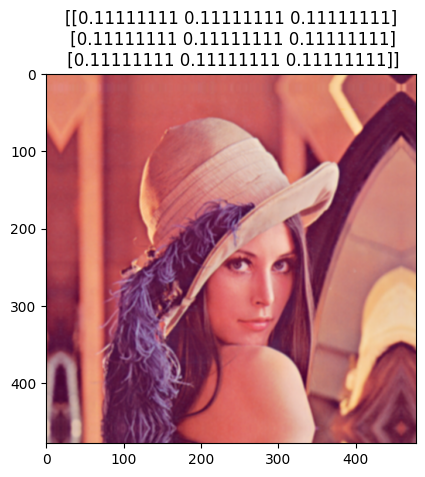

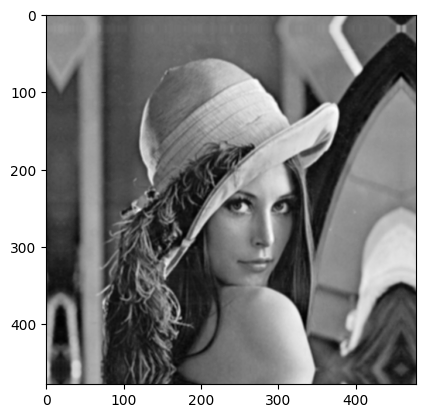

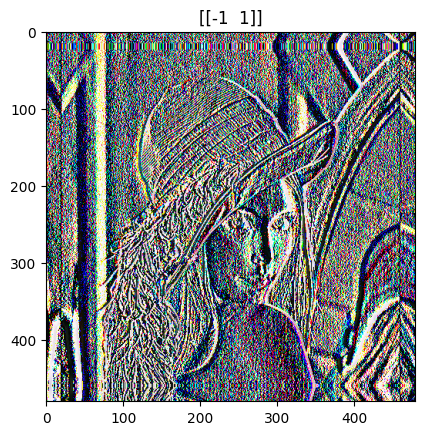

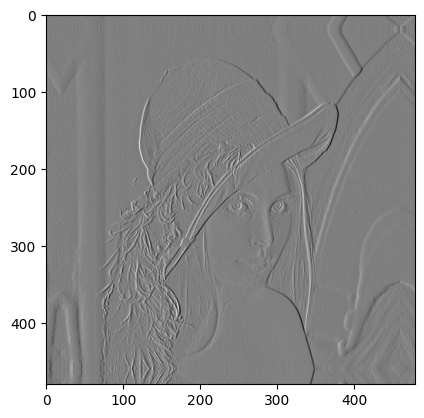

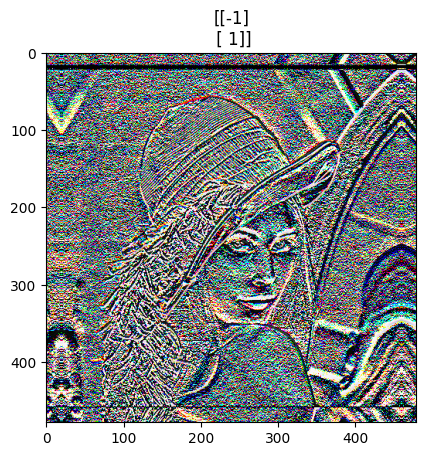

...

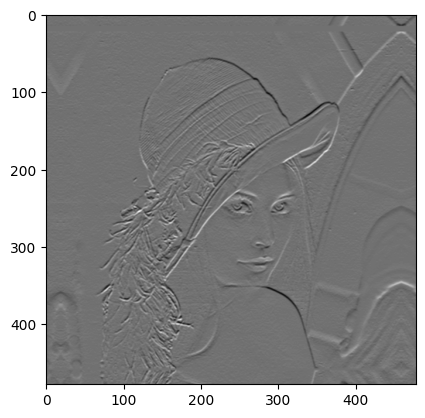

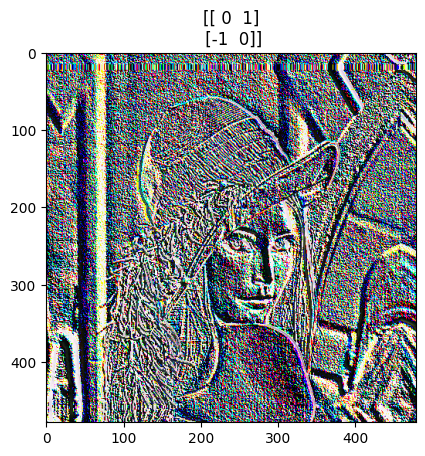

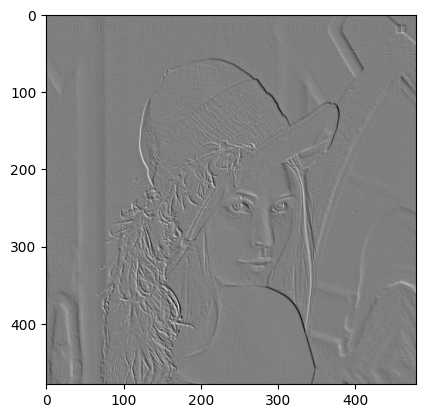

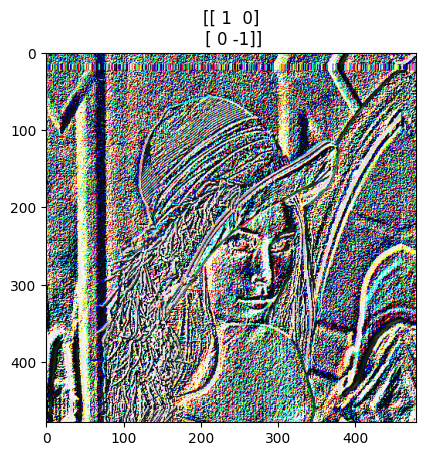

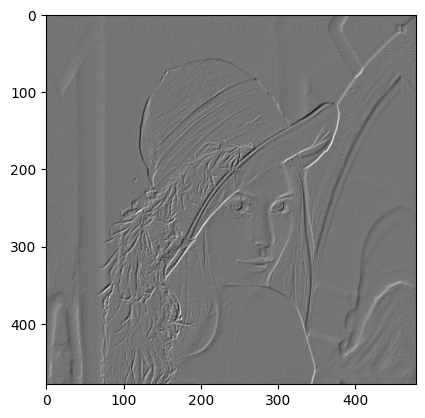

In [119]:
for kernel in kernel_list:
    new_img_rgb = get_convolved_img_shape(img_rgb_padded, kernel)
    new_img_rgb = convolution(img_rgb_padded,new_img_rgb,kernel)
    
    
    new_img_gray = get_convolved_img_shape(img_gray_padded, kernel)
    new_img_gray = convolution(img_gray_padded,new_img_gray,kernel)
    plt.title(str(kernel))
    plt.imshow(new_img_rgb.astype(np.uint8))
    plt.show()
    plt.imshow(new_img_gray,cmap ="gray")
    plt.show()
    

For wolves image

libpng warning: iCCP: known incorrect sRGB profile


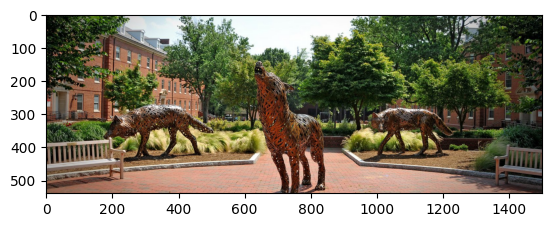

In [121]:
img_bgr2 = cv2.imread("/Users/tanishakhurana/Desktop/tkhuran3_project02/wolves.png")
img_rgb2 = cv2.cvtColor(img_bgr2, cv2.COLOR_BGR2RGB)
img_gray2 = cv2.cvtColor(img_bgr2, cv2.COLOR_BGR2GRAY)
plt.imshow(img_rgb2)

In [124]:
img_gray_padded2 = reflection_padding(padding,img_gray2)
img_rgb_padded2 = reflection_padding(padding,img_rgb2)


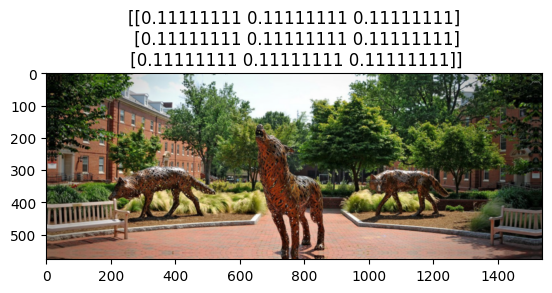

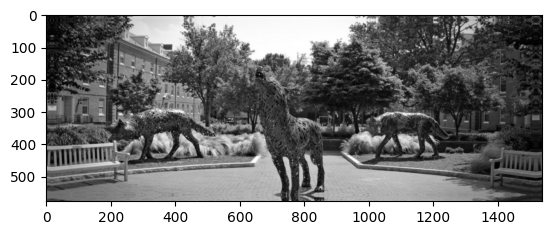

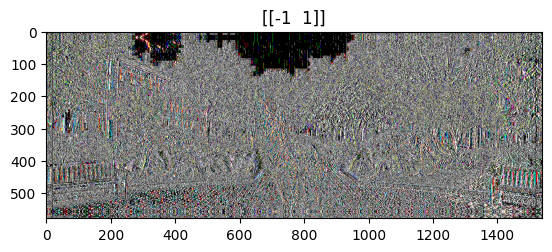

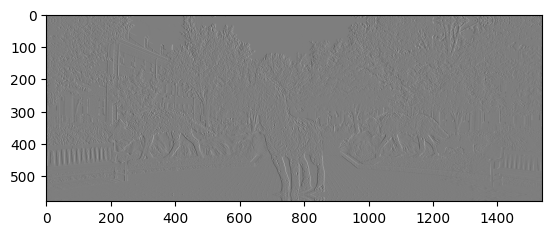

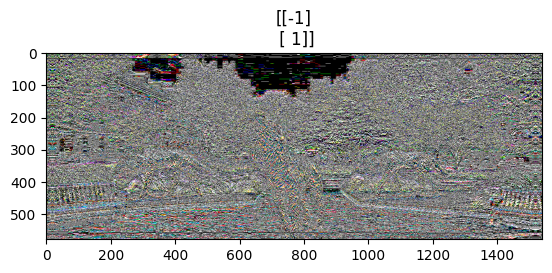

...

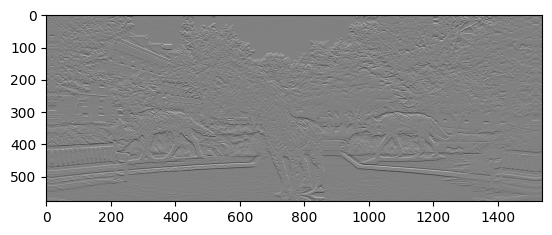

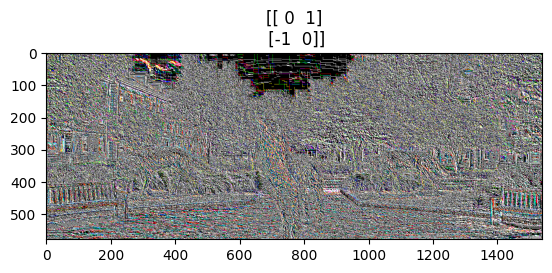

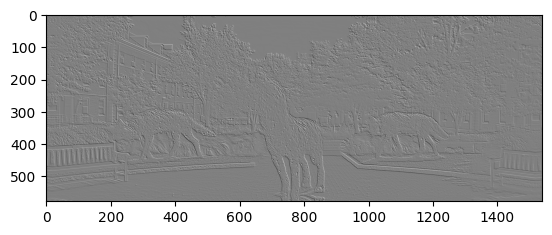

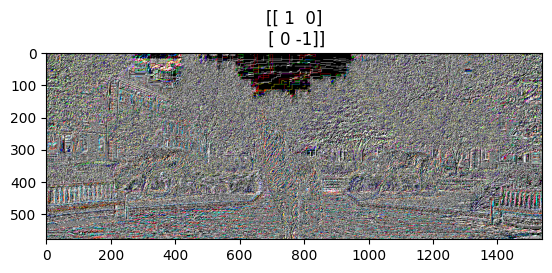

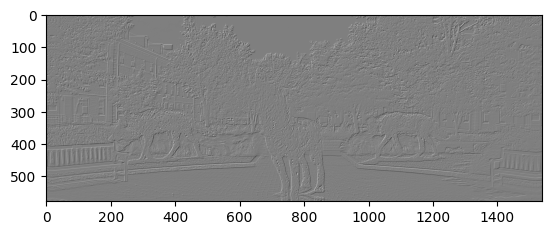

In [125]:
for kernel in kernel_list:
    
    new_img_rgb2 = get_convolved_img_shape(img_rgb_padded2, kernel)
    new_img_rgb2 = convolution(img_rgb_padded2,new_img_rgb2,kernel)
    
    
    new_img_gray2 = get_convolved_img_shape(img_gray_padded2, kernel)
    new_img_gray2 = convolution(img_gray_padded2,new_img_gray2,kernel)
    plt.title(str(kernel))
    plt.imshow(new_img_rgb2.astype(np.uint8))
    plt.show()
    plt.imshow(new_img_gray2,cmap ="gray")
    plt.show()
    

In [132]:
def get_padding_type(pad_type,img):
    if pad_type =="zero":
        img_padded = zero_padding(padding,img)
    if pad_type =="wrap around":
        img_padded = wrap_around(padding,img)
    if pad_type =="copy edge":
        img_padded = copy_edge_padding(padding,img)
    if pad_type =="reflect across edge":
        img_padded = reflection_padding(padding,img)
    return img_padded

In [133]:
def conv(img,kernel,pad):
    img_padded = get_padding_type(pad,img)
    new_img = get_convolved_img_shape(img_padded, kernel)
    if len(img_padded.shape) ==2:
        # convolution grayscale
        for row in range(new_img.shape[0]):
            for col in range(new_img.shape[1]):
                new_img[row,col] = np.sum(img_padded[row:row+kernel.shape[0],col:col + kernel.shape[1]] * kernel)

    if len(img_padded.shape) ==3:
        # #convolution rgb 
        for row in range(new_img.shape[0]):
            for col in range(new_img.shape[1]):
                for channel in range(new_img.shape[2]):
                    new_img[row,col,channel] = np.sum(img_padded[row:row+kernel.shape[0],col:col + kernel.shape[1],channel] * kernel)
                    
    return new_img


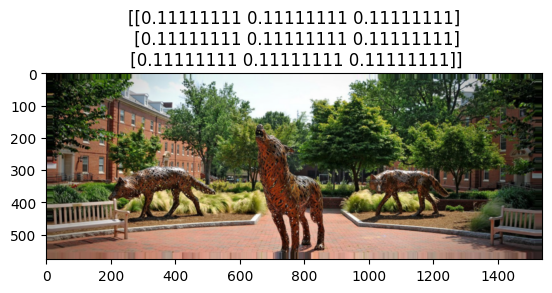

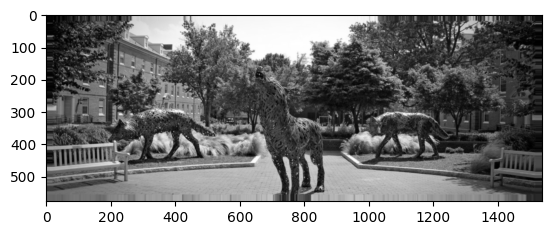

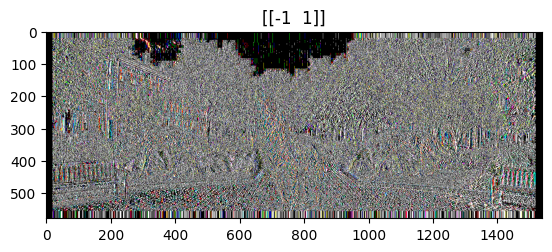

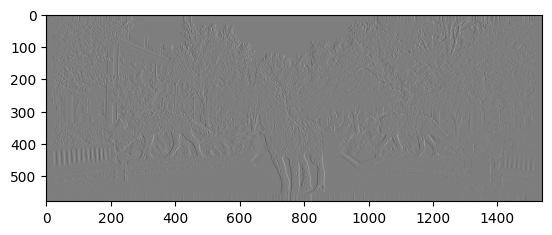

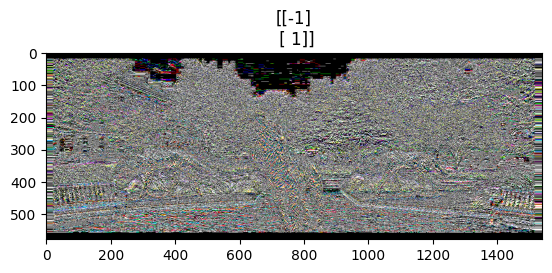

...

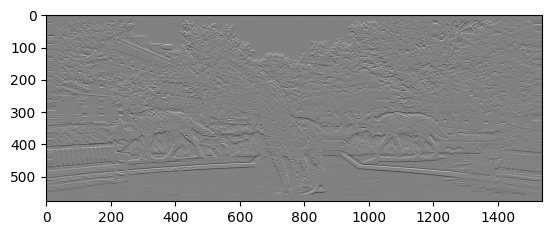

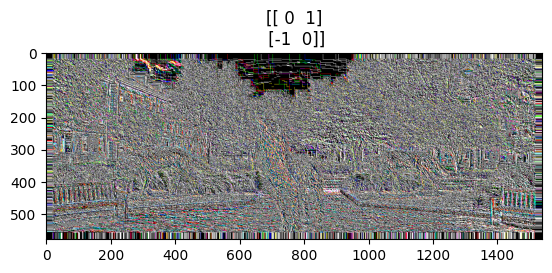

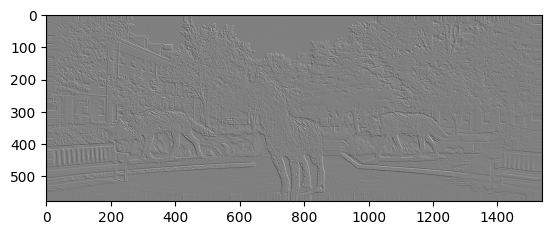

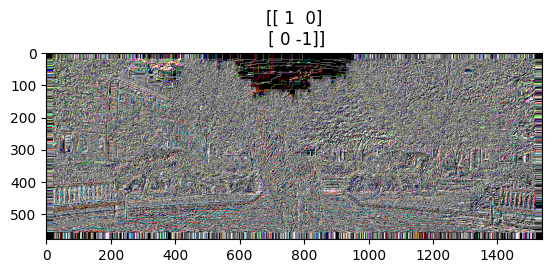

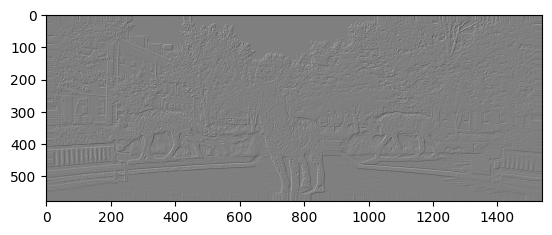

In [134]:
for kernel in kernel_list:
    new_img_rgb2 = conv(img_rgb2,kernel,"copy edge")

    new_img_gray2 = conv(img_gray2,kernel,"copy edge")
    plt.title(str(kernel))
    plt.imshow(new_img_rgb2.astype(np.uint8))
    plt.show()
    plt.imshow(new_img_gray2,cmap ="gray")
    plt.show()
    
        

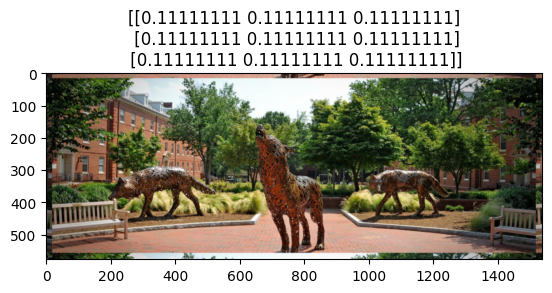

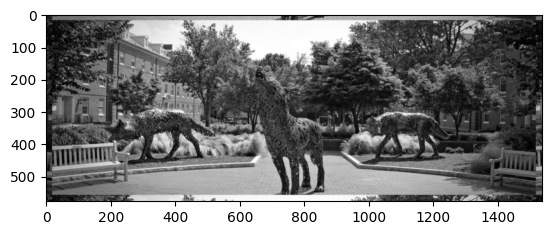

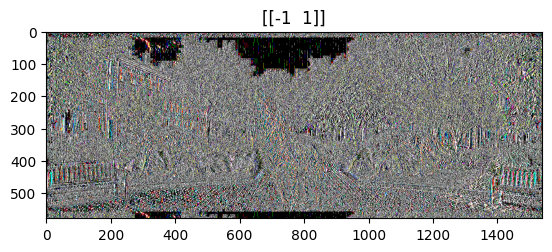

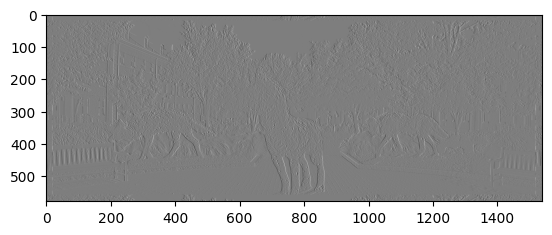

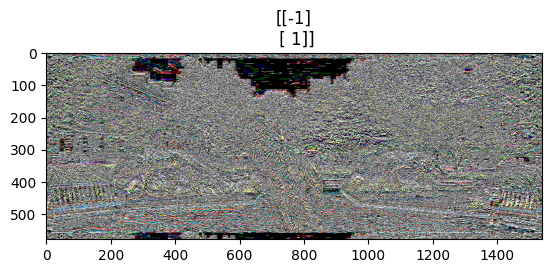

...

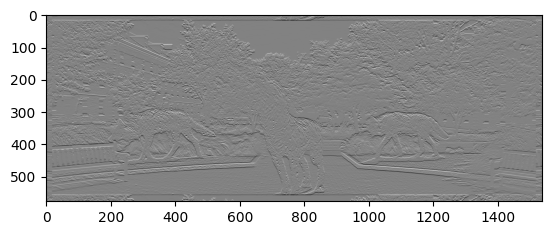

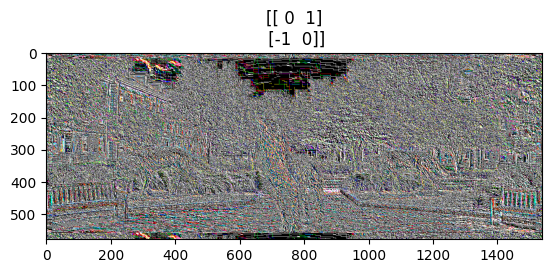

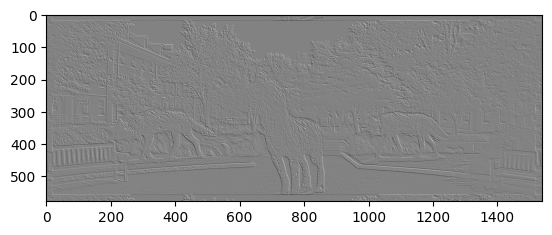

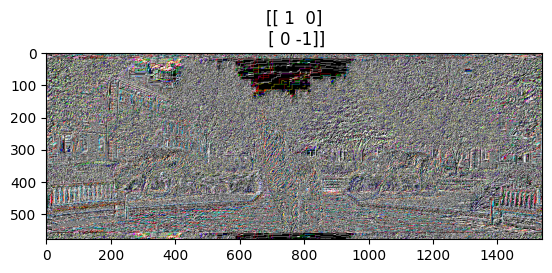

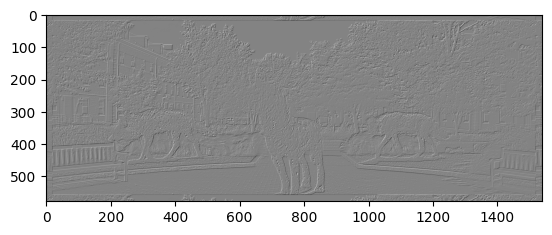

In [135]:
for kernel in kernel_list:
    new_img_rgb2 = conv(img_rgb2,kernel,"wrap around")

    new_img_gray2 = conv(img_gray2,kernel,"wrap around")
    plt.title(str(kernel))
    plt.imshow(new_img_rgb2.astype(np.uint8))
    plt.show()
    plt.imshow(new_img_gray2,cmap ="gray")
    plt.show()
    

Problem 1, part b)

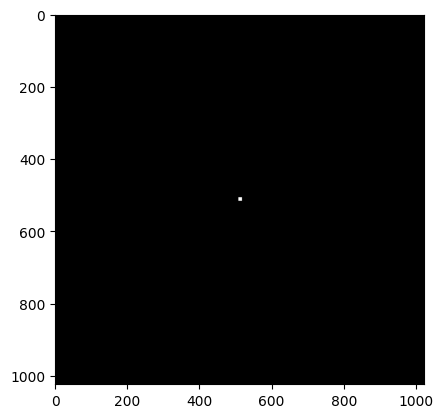

In [170]:
gray_img = np.zeros((1024,1023),np.uint8)
gray_img[512 -5:512 +5,512-5:512+5] = 1
plt.imshow(gray_img,cmap ="gray")


In [171]:
gray_unit_impulse = conv(gray_img,prewitt_y,"zero")

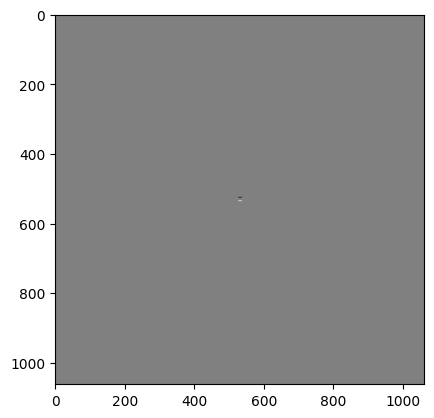

In [172]:
plt.imshow(gray_unit_impulse,cmap ="gray")

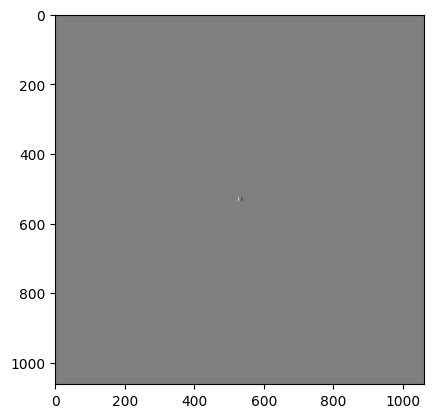

In [173]:
gray_unit_impulse = conv(gray_img,prewitt_x,"zero")
plt.imshow(gray_unit_impulse,cmap ="gray")

In [174]:
np.nonzero(gray_unit_impulse)

(array([525, 525, 525, 525, 526, 526, 526, 526, 527, 527, 527, 527, 528,
        528, 528, 528, 529, 529, 529, 529, 530, 530, 530, 530, 531, 531,
        531, 531, 532, 532, 532, 532, 533, 533, 533, 533, 534, 534, 534,
        534, 535, 535, 535, 535, 536, 536, 536, 536]),
 array([525, 526, 535, 536, 525, 526, 535, 536, 525, 526, 535, 536, 525,
        526, 535, 536, 525, 526, 535, 536, 525, 526, 535, 536, 525, 526,
        535, 536, 525, 526, 535, 536, 525, 526, 535, 536, 525, 526, 535,
        536, 525, 526, 535, 536, 525, 526, 535, 536]))

In [158]:
import sys
np.set_printoptions(threshold=sys.maxsize)


In [175]:
print(gray_unit_impulse[524:537,524:537])

[[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]
 [ 0.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0. -1. -1.]
 [ 0.  2.  2.  0.  0.  0.  0.  0.  0.  0.  0. -2. -2.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  3.  3.  0.  0.  0.  0.  0.  0.  0.  0. -3. -3.]
 [ 0.  2.  2.  0.  0.  0.  0.  0.  0.  0.  0. -2. -2.]
 [ 0.  1.  1.  0.  0.  0.  0.  0.  0.  0.  0. -1. -1.]]
